In [ ]:
import pandas as pd
import numpy as np
import re
from sklearn.datasets import fetch_20newsgroups
from matplotlib import pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
from collections import defaultdict
from sklearn.decomposition import PCA

# Data Collection

In [2]:
dataset = fetch_20newsgroups(subset='all', 
                shuffle=False, remove=('headers', 'footers', 'quotes'))

In [3]:
df = pd.DataFrame()
df["data"] = dataset["data"]
df["target"] = dataset["target"]
df["target_names"] = df.target.apply(lambda row: dataset["target_names"][row])
df.head()

,data,target,target_names
0,\nmorgan and guzman will have era's 1 run high...,9,rec.sport.baseball
1,"Well, I just got my Centris 610 yesterday. It...",4,comp.sys.mac.hardware
2,Archive-name: cryptography-faq/part10\nLast-mo...,11,sci.crypt
3,To the best of my knowledge there aren't any p...,4,comp.sys.mac.hardware
4,\n\nI think that domestication will change beh...,0,alt.atheism


In [18]:
df['target_names'].value_counts()

target_names
rec.sport.hockey            999
soc.religion.christian      997
rec.motorcycles             996
rec.sport.baseball          994
sci.crypt                   991
sci.med                     990
rec.autos                   990
comp.windows.x              988
sci.space                   987
comp.os.ms-windows.misc     985
sci.electronics             984
comp.sys.ibm.pc.hardware    982
misc.forsale                975
comp.graphics               973
comp.sys.mac.hardware       963
talk.politics.mideast       940
talk.politics.guns          910
alt.atheism                 799
talk.politics.misc          775
talk.religion.misc          628
Name: count, dtype: int64

# Data Preprocessing

In [ ]:
import re
import nltk
import string
from bs4 import BeautifulSoup
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer

nltk.download('stopwords')

stop_words = set(stopwords.words('english'))
stemmer = PorterStemmer()

def preprocess(text):
    text = text.lower()

    # Remove emails
    text = re.sub(r'\S+@\S+', ' ', text)

    # Remove URLs
    text = re.sub(r'http\S+|www\S+', ' ', text)

    # Remove HTML tags
    text = BeautifulSoup(text, "html.parser").get_text()

    # Remove digits
    text = re.sub(r'\d+', '', text)

    # Remove punctuation
    text = text.translate(str.maketrans('', '', string.punctuation))

    # Tokenization and stopword removal + stemming
    tokens = text.split()
    tokens = [stemmer.stem(word) for word in tokens if word not in stop_words]

    return ' '.join(tokens)

df["data_str"] = df.data.apply(lambda row: preprocess(row) )


[nltk_data] Downloading package stopwords to /usr/share/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


<ipython-input-6-04c435658ddc>:23: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  text = BeautifulSoup(text, "html.parser").get_text()


# clustering & Visualization

## Kmeans Clustering

Ngram: (1, 1), Perplexity: 10
Silhouette Score: 0.3309


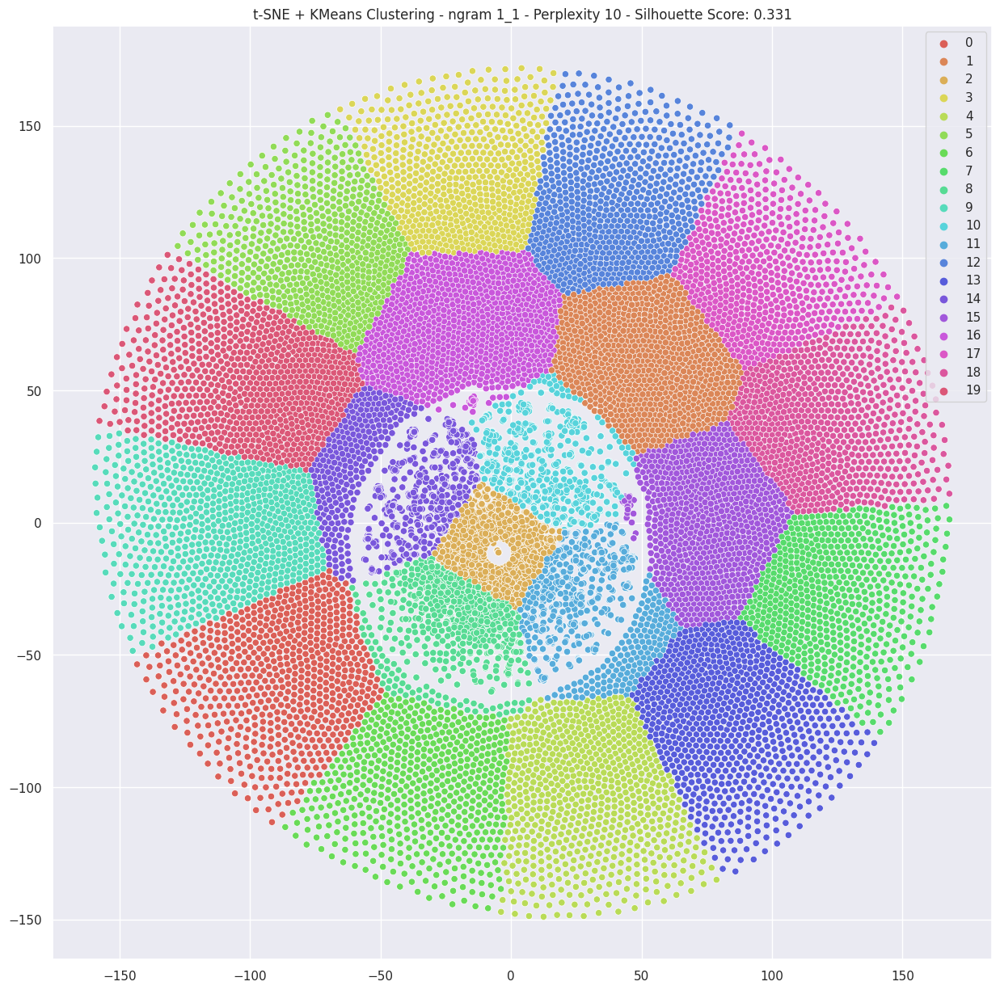

Ngram: (1, 2), Perplexity: 10
Silhouette Score: 0.3395


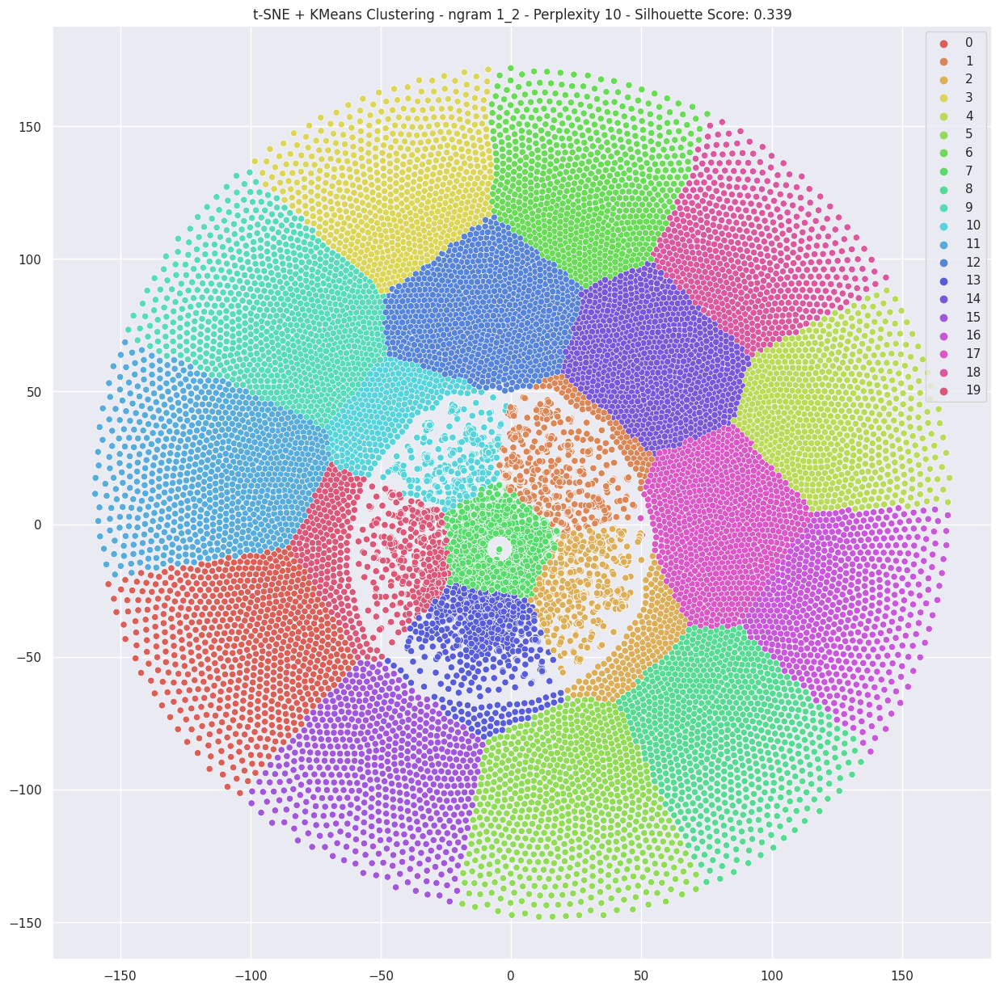

Ngram: (1, 3), Perplexity: 10
Silhouette Score: 0.3301


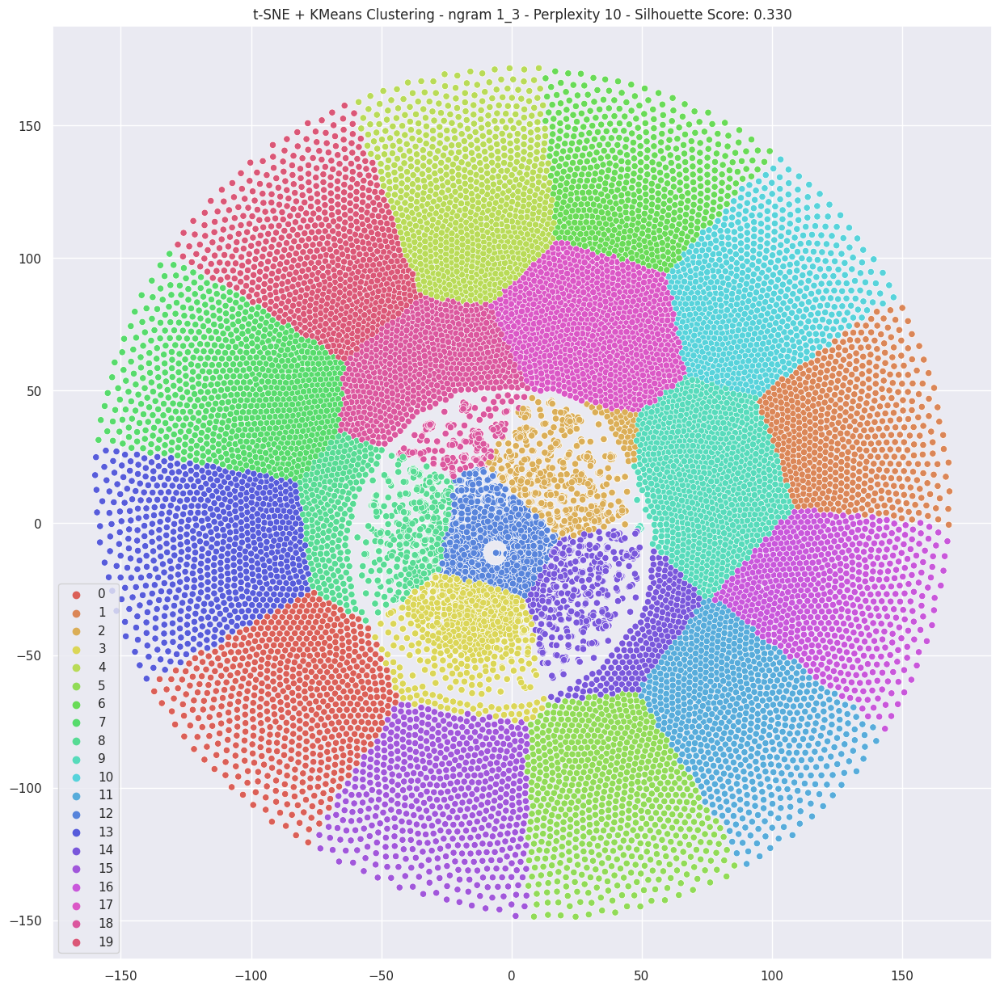

Ngram: (2, 2), Perplexity: 10
Silhouette Score: 0.4805


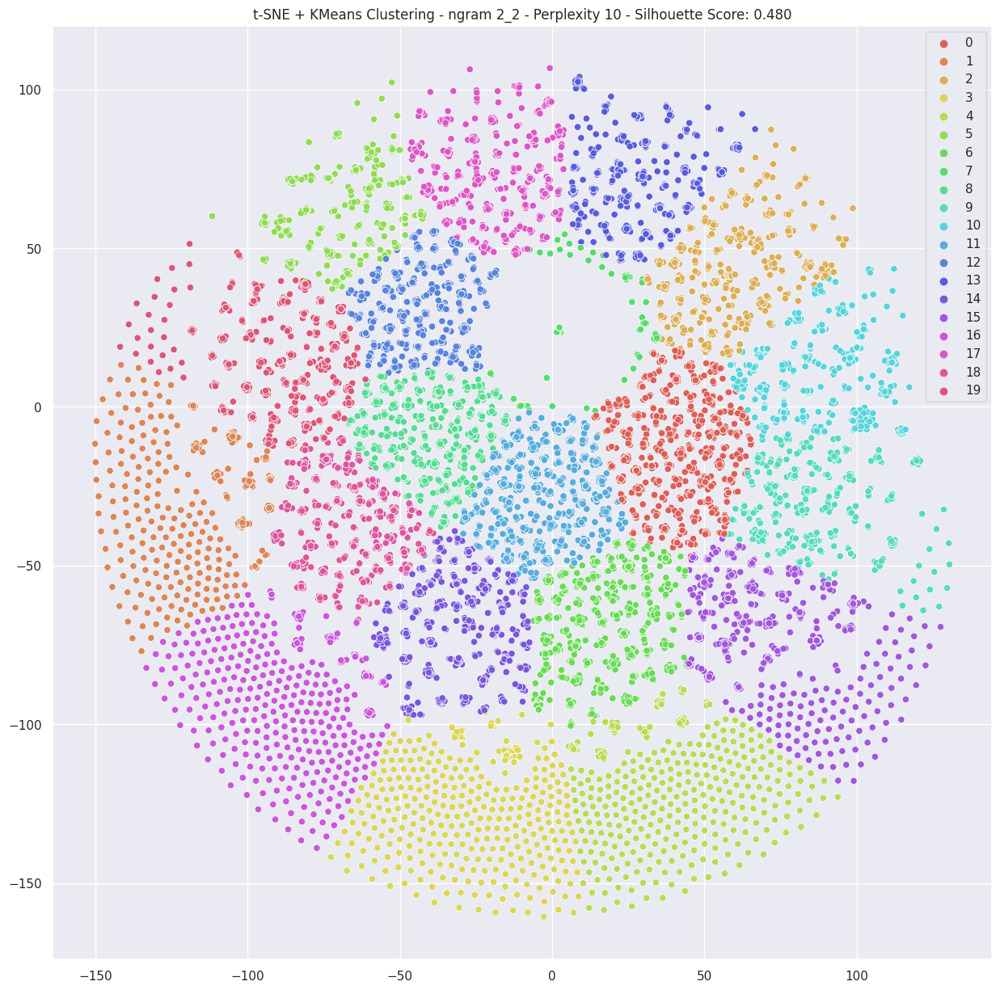

Ngram: (3, 3), Perplexity: 10
Silhouette Score: 0.8671


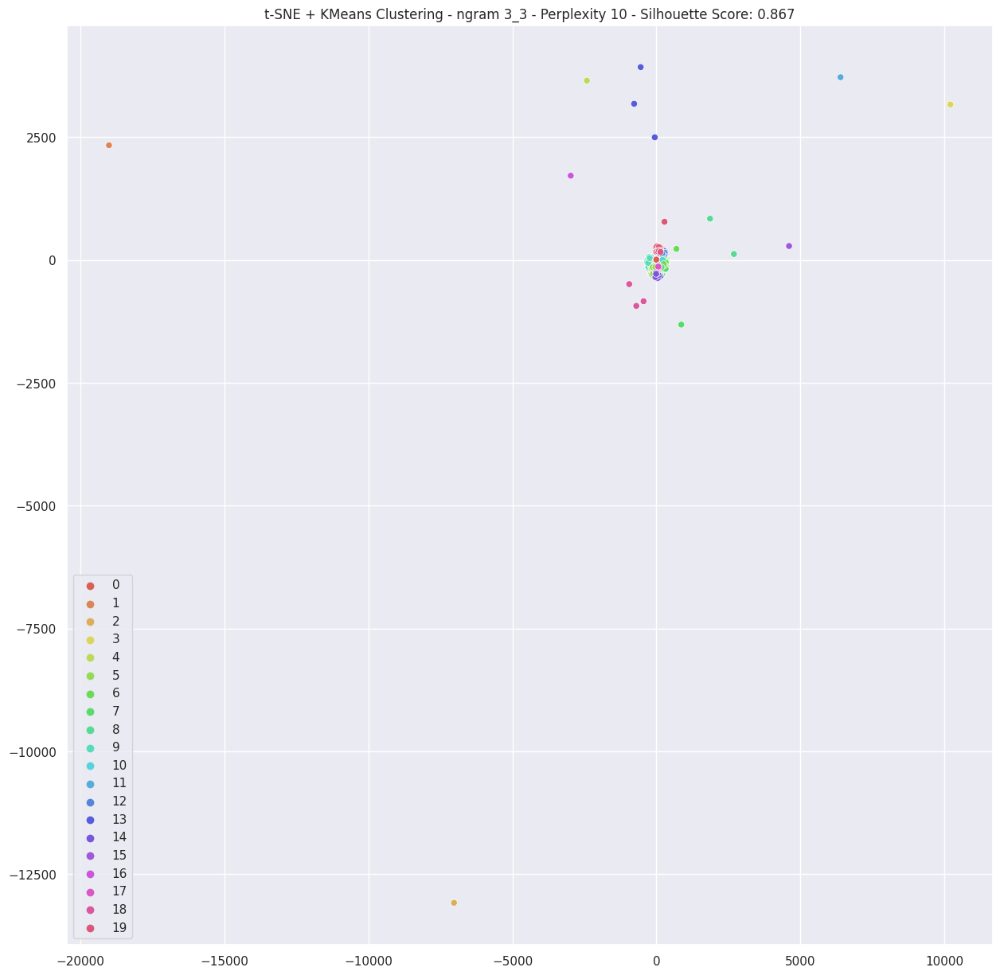

Ngram: (1, 1), Perplexity: 30
Silhouette Score: 0.3250


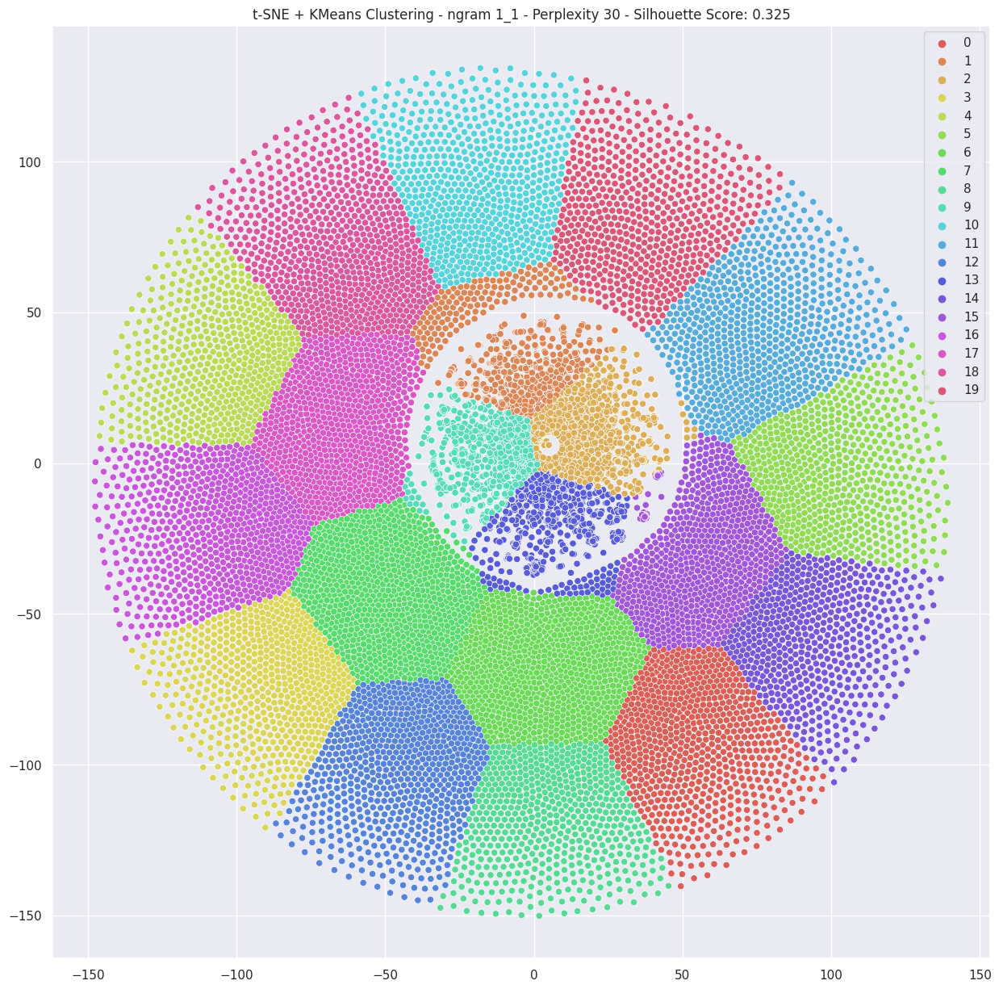

Ngram: (1, 2), Perplexity: 30
Silhouette Score: 0.3363


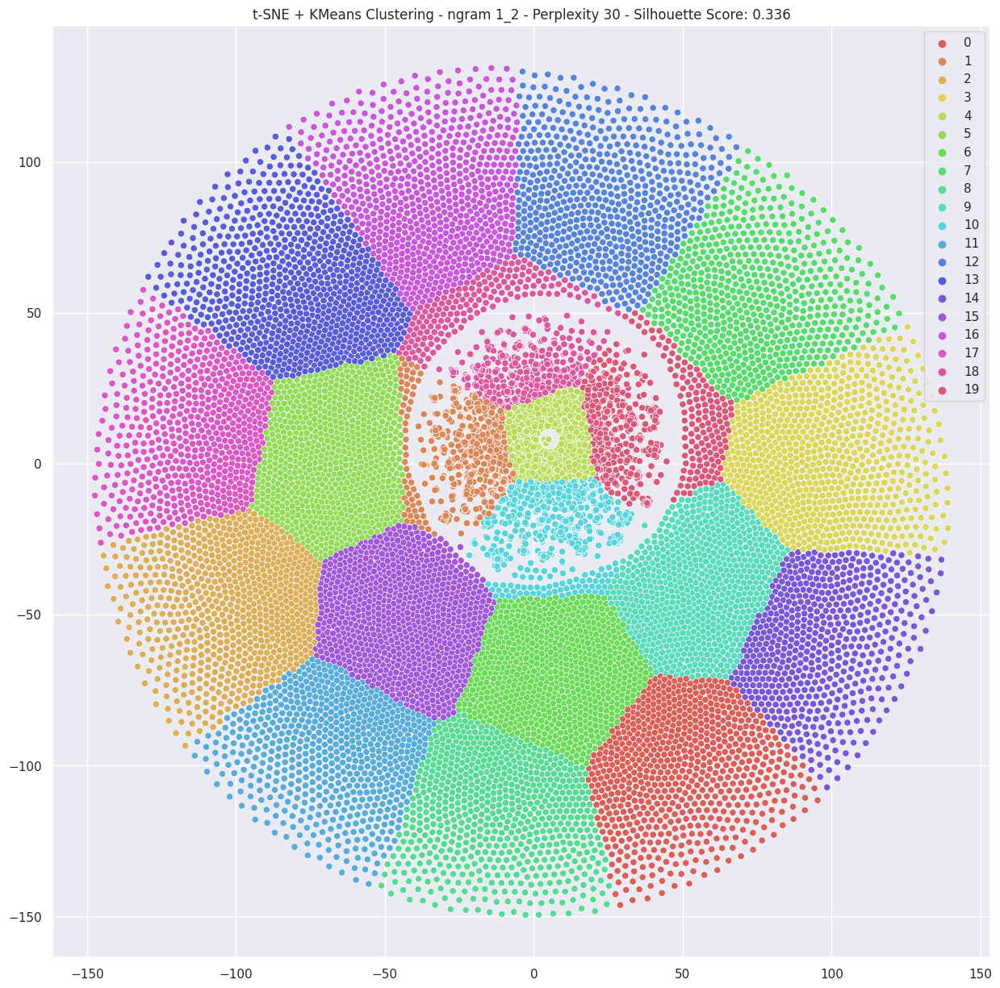

Ngram: (1, 3), Perplexity: 30
Silhouette Score: 0.3292


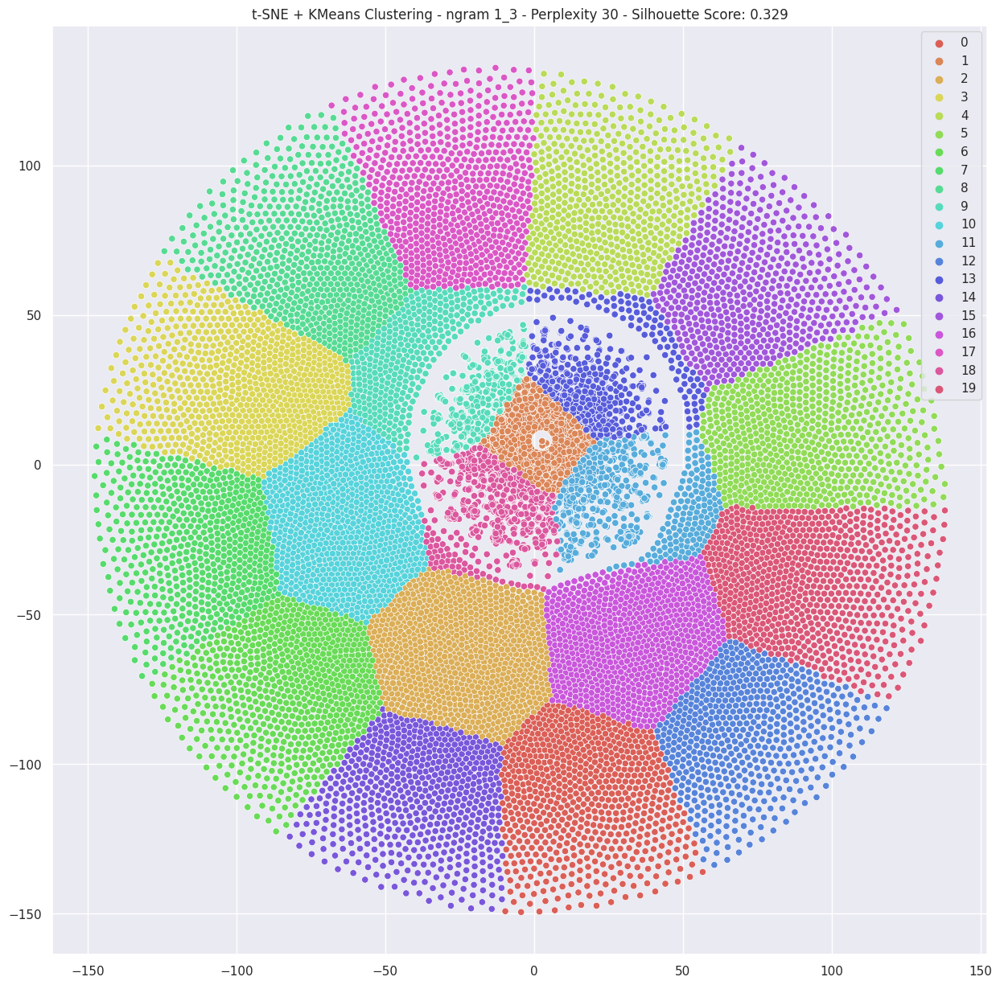

Ngram: (2, 2), Perplexity: 30
Silhouette Score: 0.4732


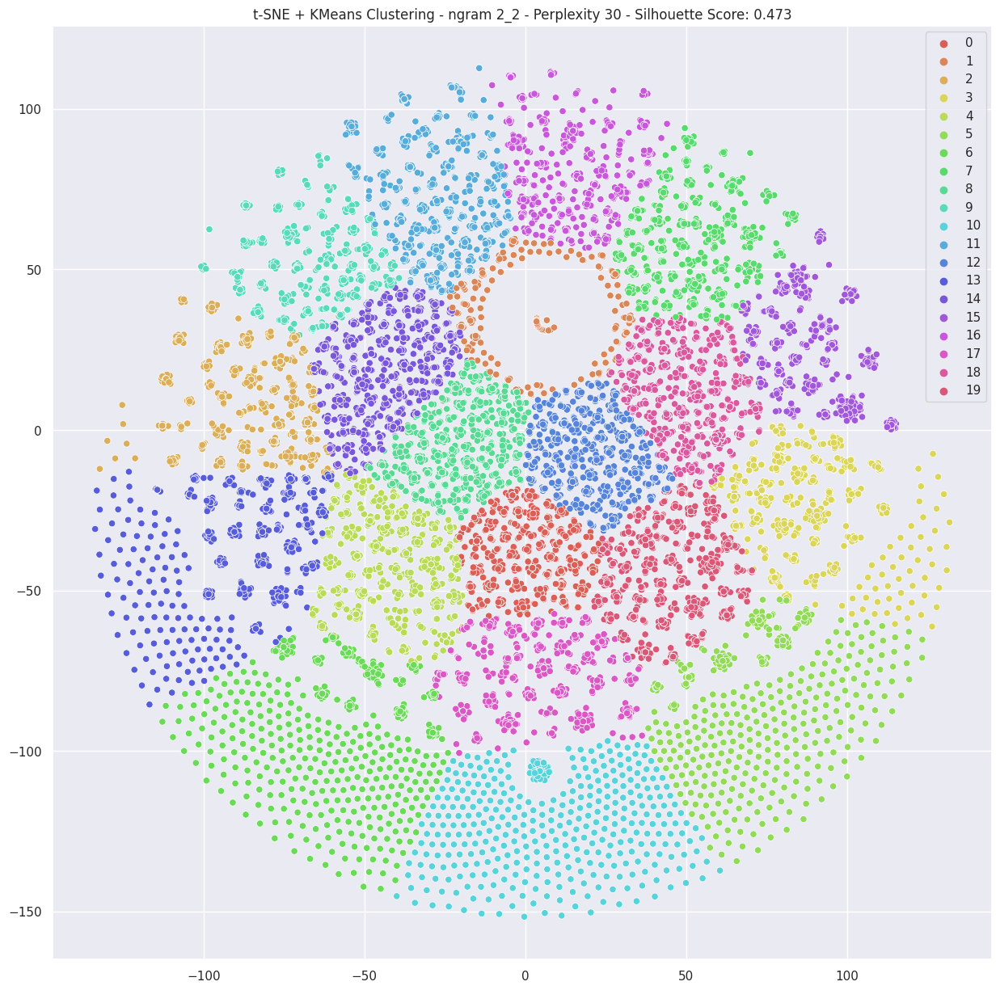

Ngram: (3, 3), Perplexity: 30
Silhouette Score: 0.8599


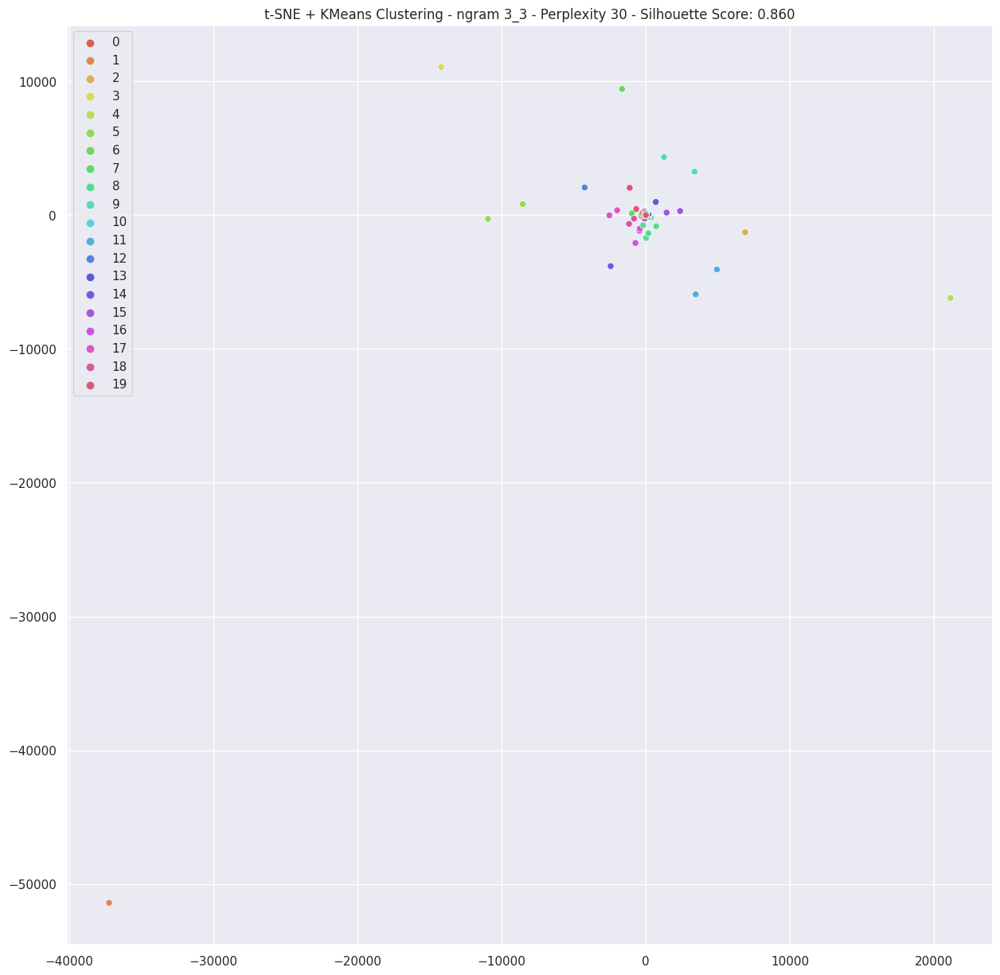

Ngram: (1, 1), Perplexity: 50
Silhouette Score: 0.3378


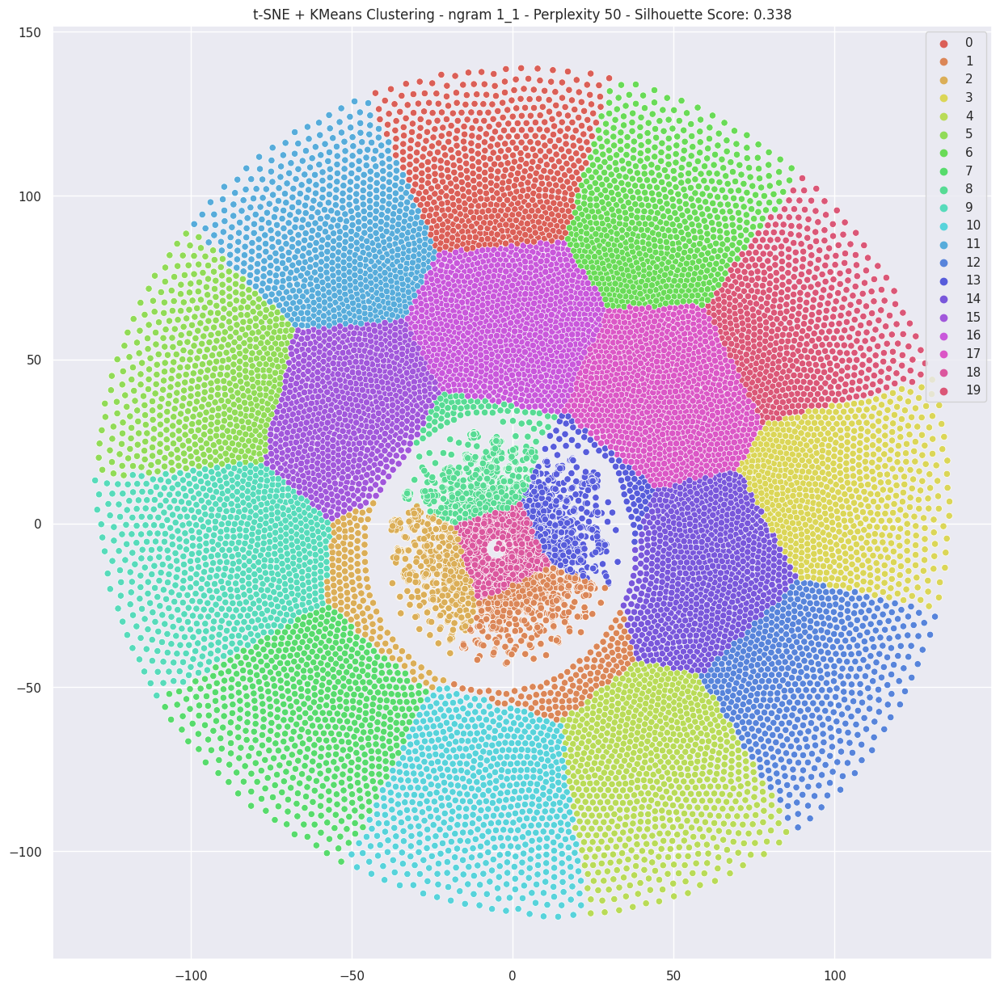

Ngram: (1, 2), Perplexity: 50
Silhouette Score: 0.3353


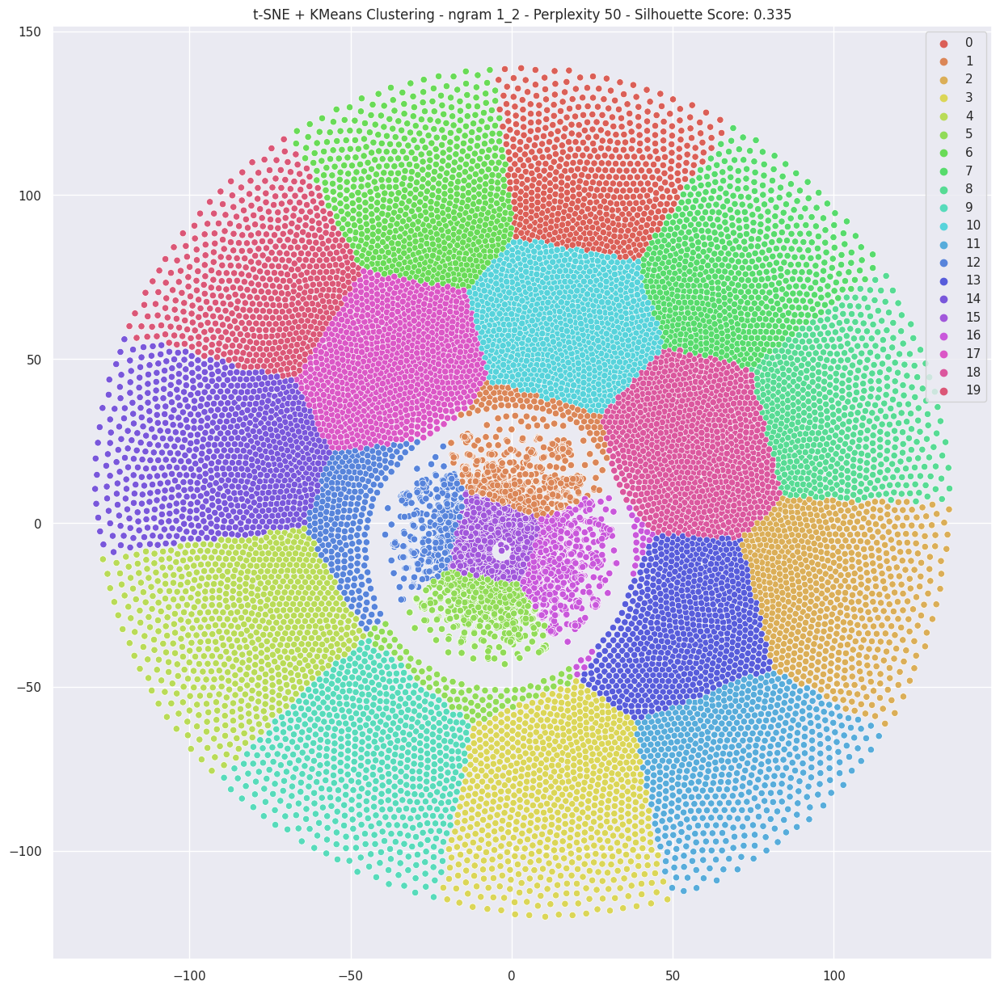

Ngram: (1, 3), Perplexity: 50
Silhouette Score: 0.3248


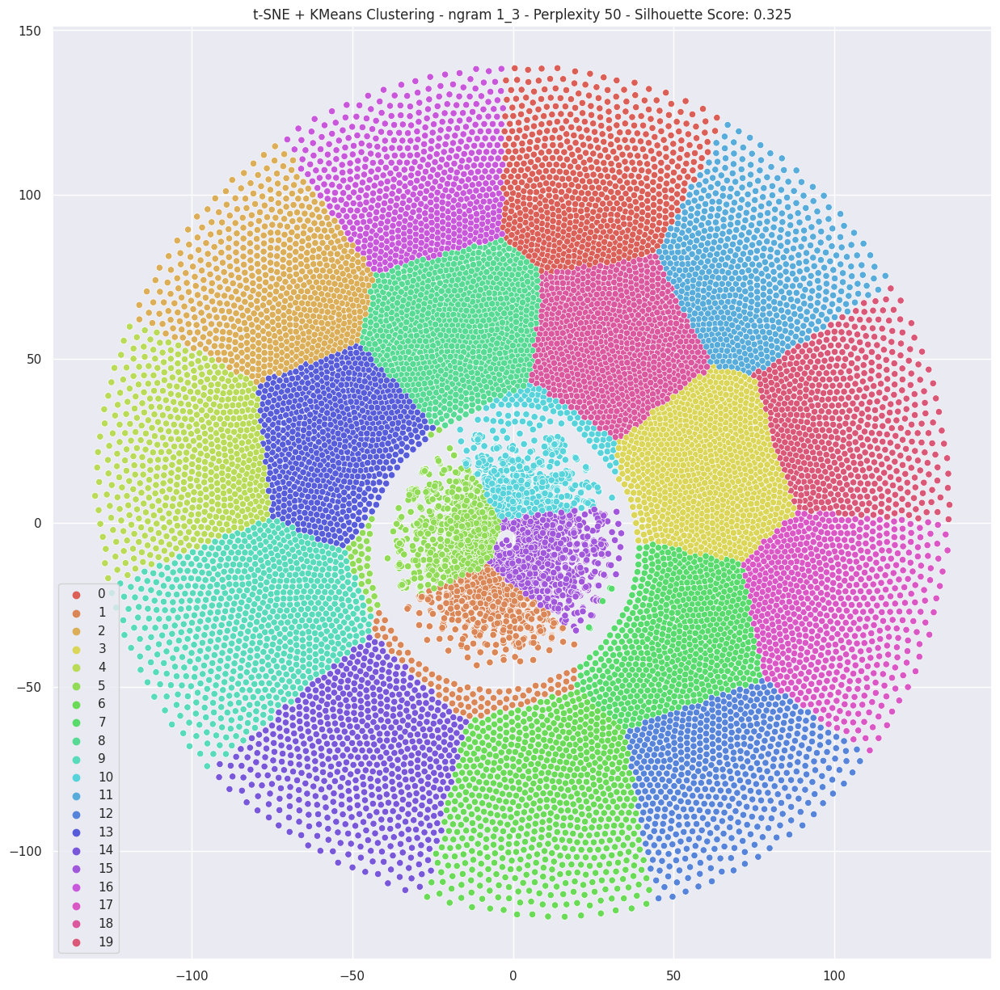

Ngram: (2, 2), Perplexity: 50
Silhouette Score: 0.4732


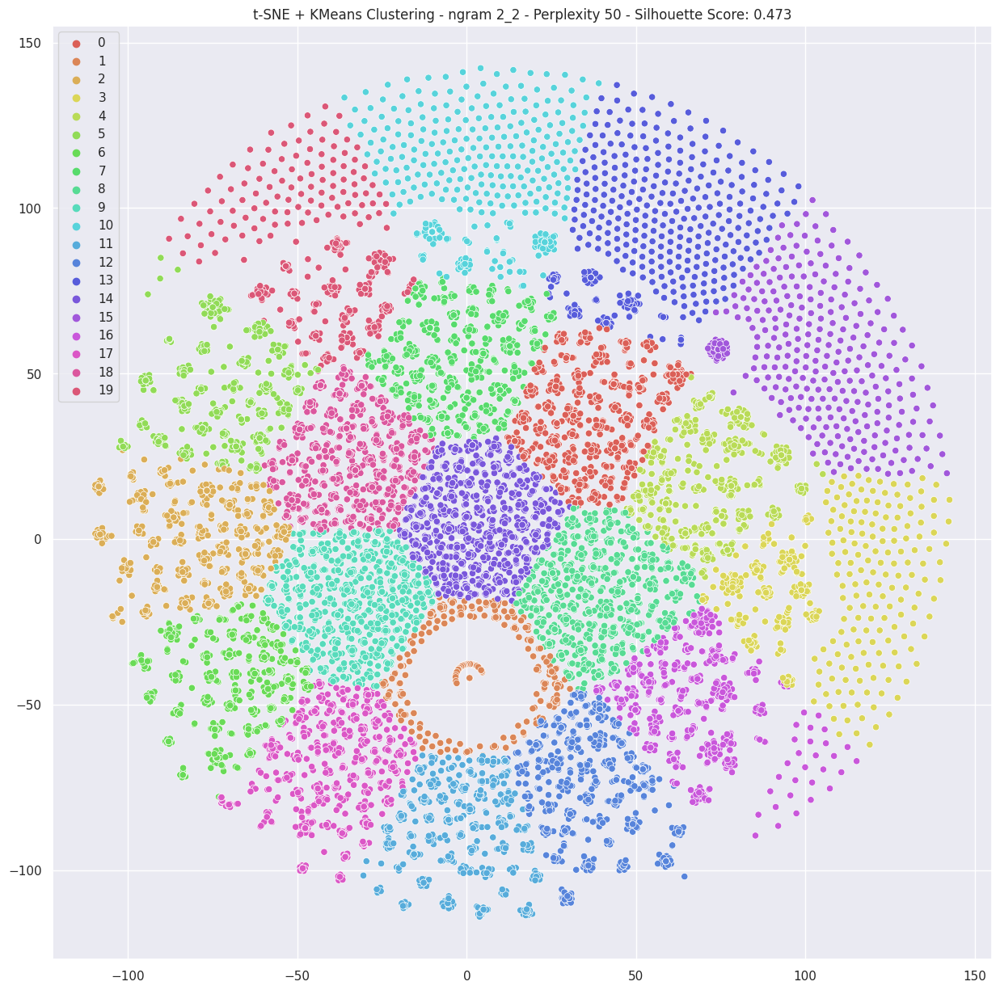

Ngram: (3, 3), Perplexity: 50
Silhouette Score: 0.8679


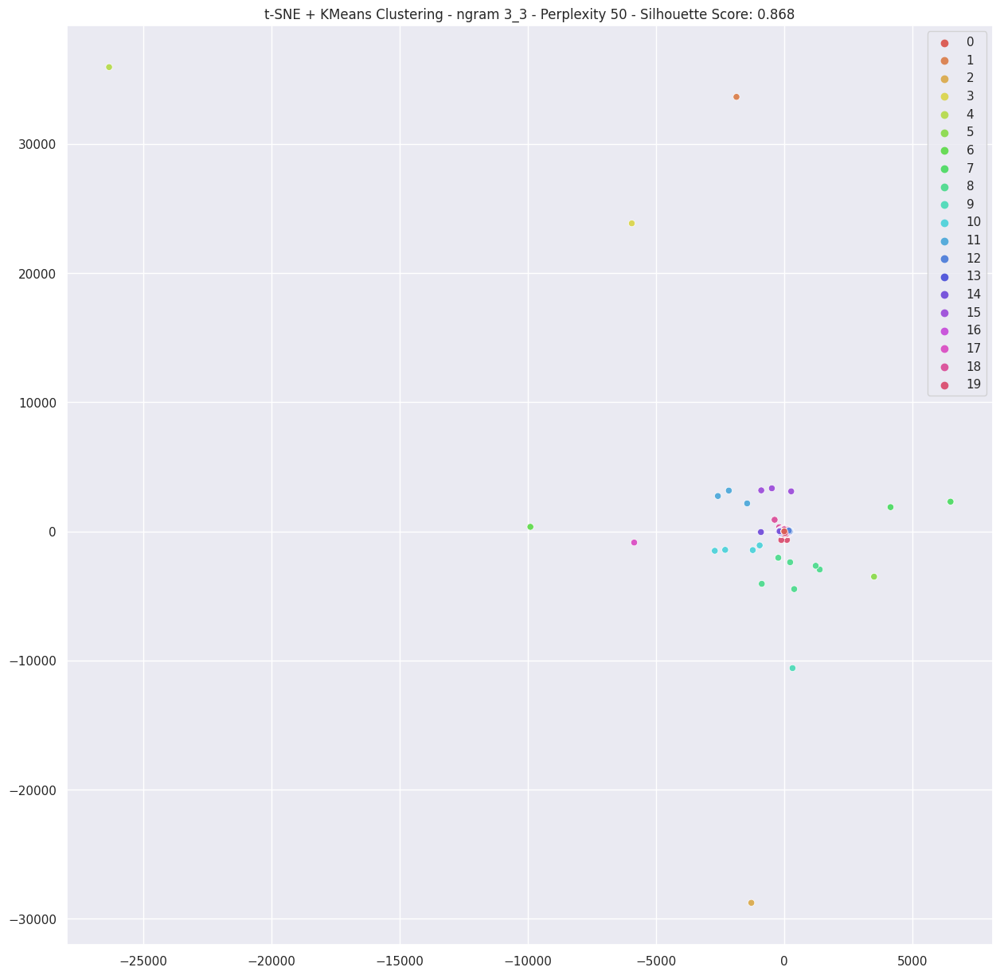

Ngram: (1, 1), Perplexity: 100
Silhouette Score: 0.3178


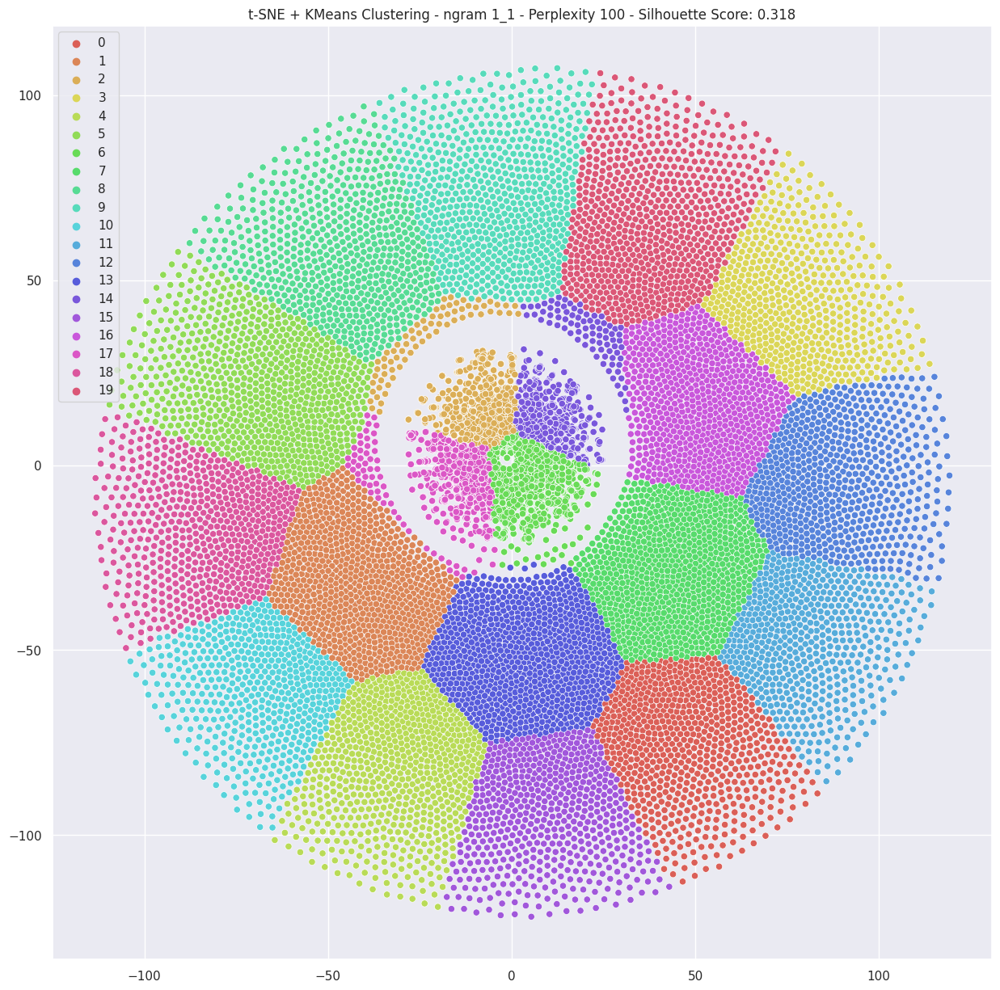

Ngram: (1, 2), Perplexity: 100
Silhouette Score: 0.3212


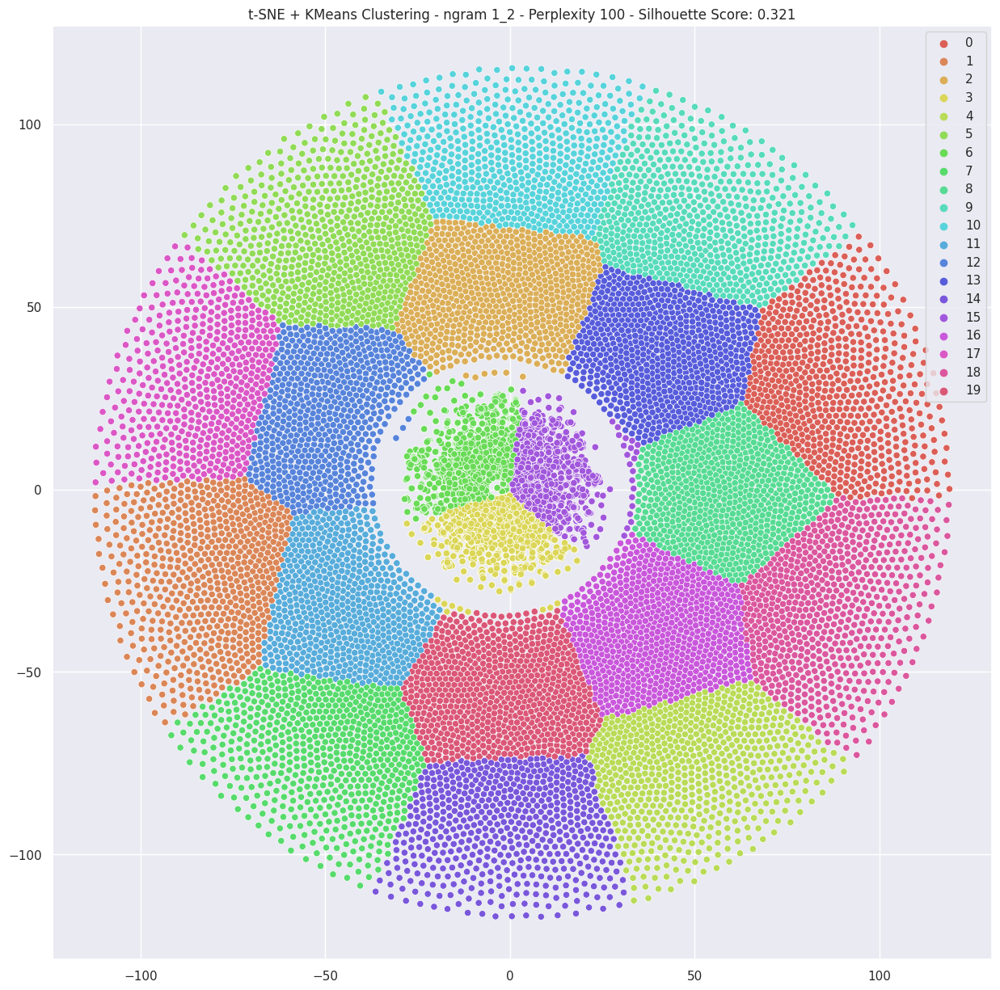

Ngram: (1, 3), Perplexity: 100
Silhouette Score: 0.3194


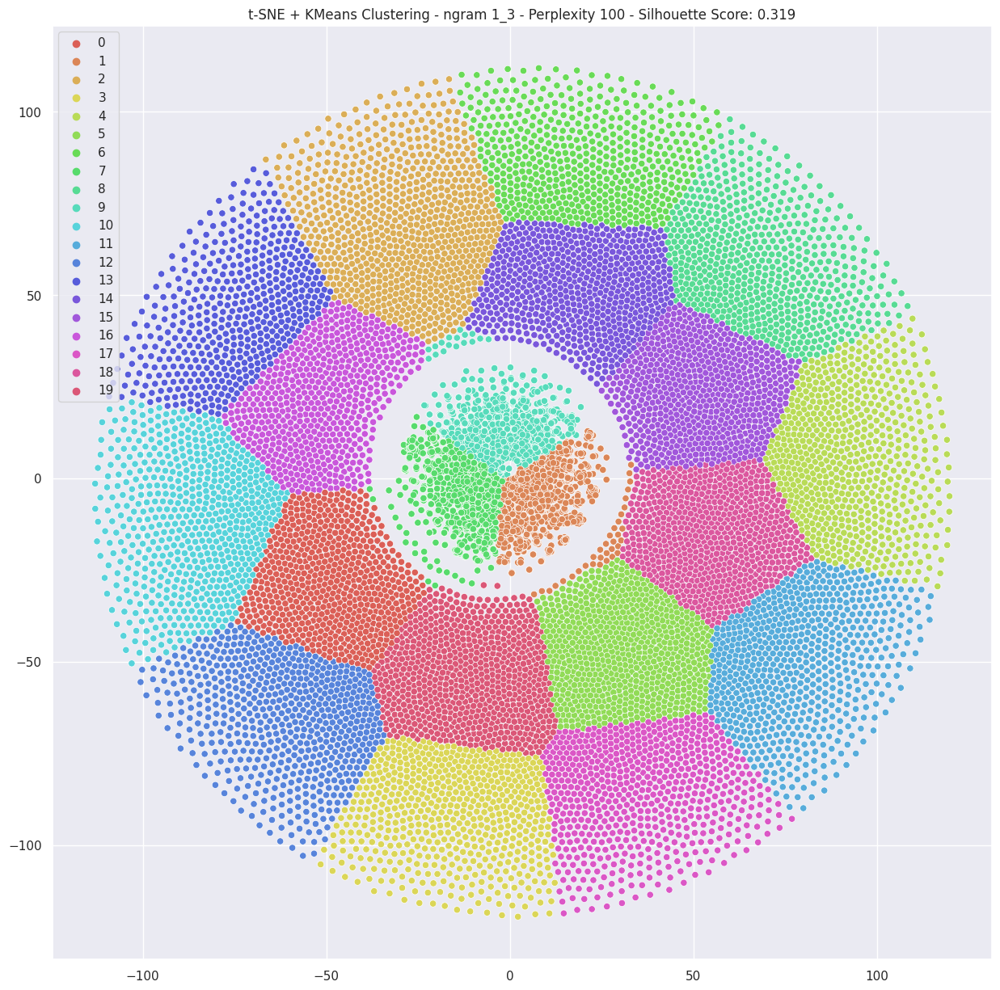

Ngram: (2, 2), Perplexity: 100
Silhouette Score: 0.4730


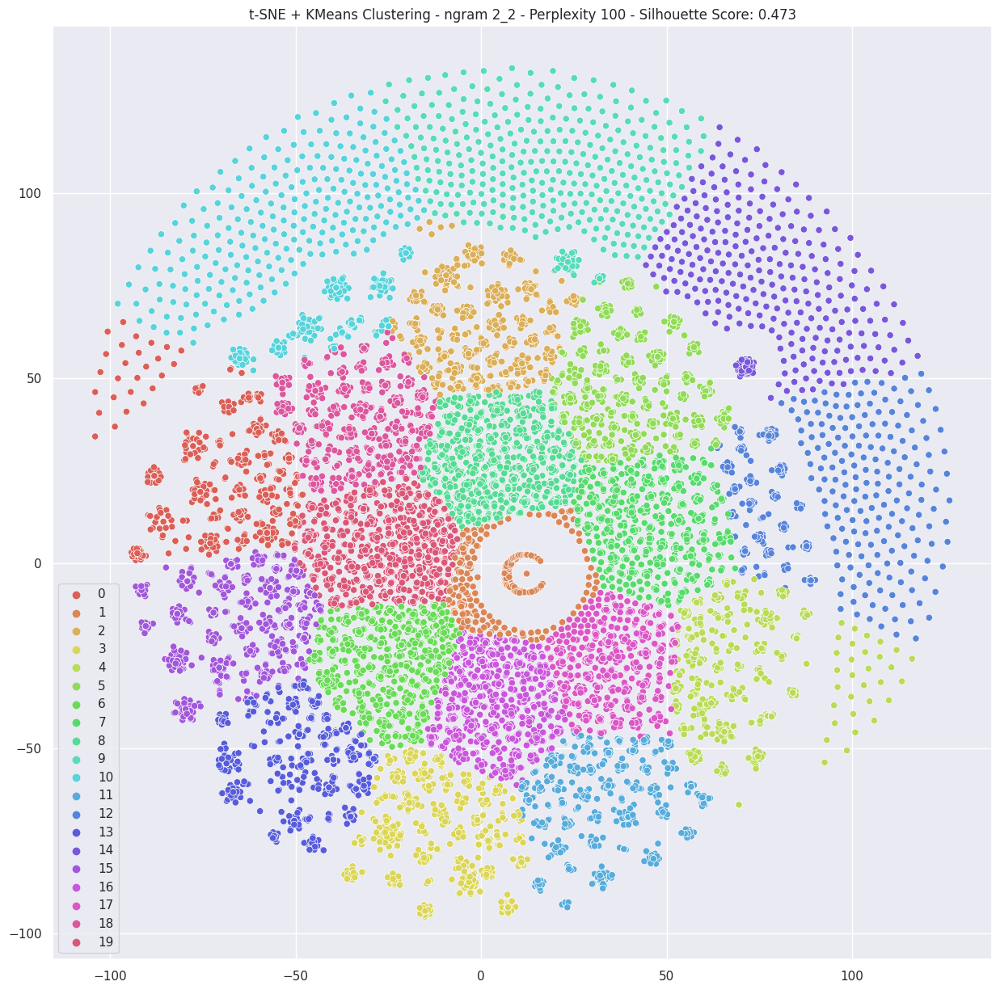

Ngram: (3, 3), Perplexity: 100
Silhouette Score: 0.8589


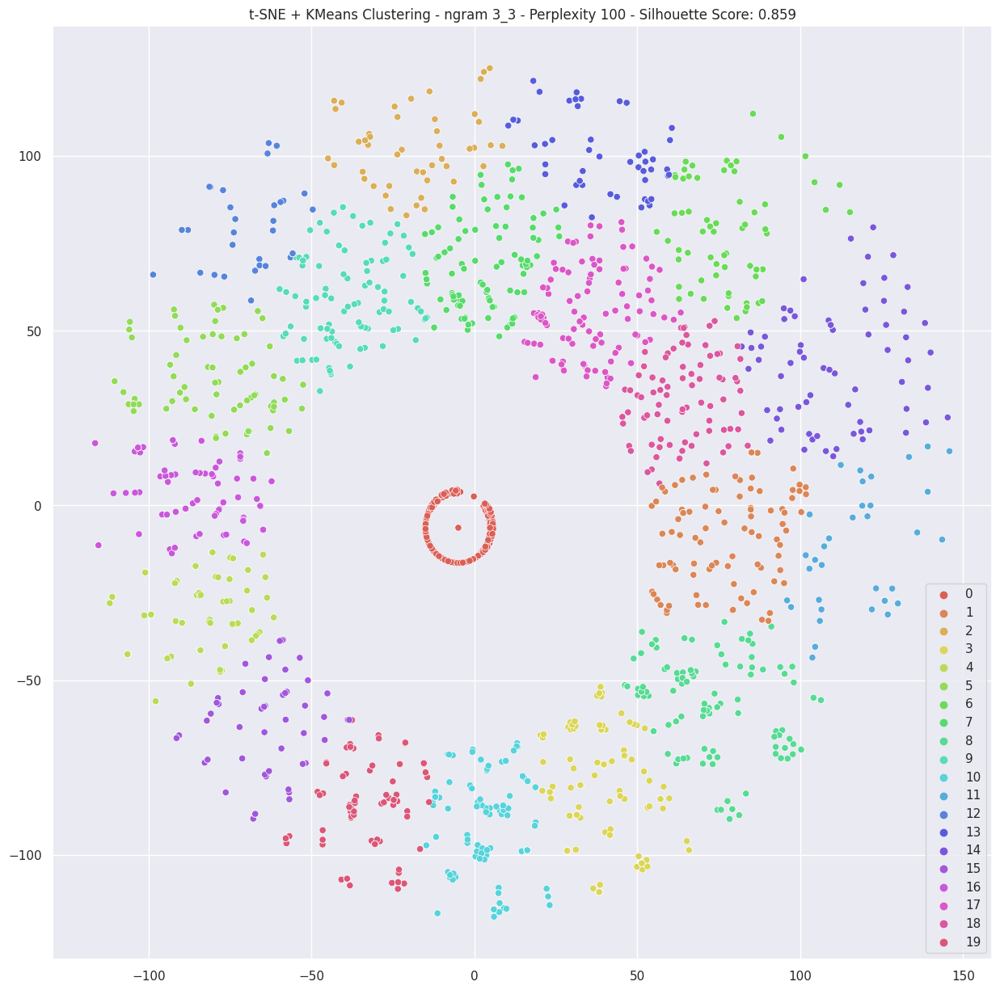

In [6]:


perp_components = defaultdict(dict)
silhouette_scores = defaultdict(dict)

best_score = -1
best_config = {}

for i in [10, 30, 50, 100]:
    for ngram in [(1, 1), (1, 2), (1, 3), (2, 2), (3, 3)]:
        # Vectorize with TF-IDF
        vectorizer = TfidfVectorizer(ngram_range=ngram, max_features=2**10)
        text_to_vector = vectorizer.fit_transform(df.data_str.values)

        print(f"Ngram: {ngram}, Perplexity: {i}")

        # Apply t-SNE
        X_embedded = TSNE(perplexity=i, random_state=42).fit_transform(text_to_vector.toarray())

        ngram_str = f"{ngram[0]}_{ngram[1]}"
        perp_components[i][ngram_str] = X_embedded

        # Apply KMeans
        n_clusters = 20  # Assuming 20 newsgroups
        kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init='auto')
        cluster_labels = kmeans.fit_predict(X_embedded)

        # Calculate silhouette score
        try:
            score = silhouette_score(X_embedded, cluster_labels)
        except:
            score = -1  # In case of error (e.g., one cluster only)

        silhouette_scores[i][ngram_str] = score

        print(f"Silhouette Score: {score:.4f}")

        # Store best config
        if score > best_score:
            best_score = score
            best_config = {'perplexity': i, 'ngram': ngram_str}

        # Plotting
        sns.set(rc={'figure.figsize': (15, 15)})
        palette = sns.color_palette("hls", n_clusters)

        sns.scatterplot(x=X_embedded[:, 0], y=X_embedded[:, 1], hue=cluster_labels, palette=palette, legend='full')
        title = f"t-SNE + KMeans Clustering - ngram {ngram_str} - Perplexity {i} - Silhouette Score: {score:.3f}"
        plt.title(title)
        plt.savefig(f"{title}.png")
        plt.show()



In [57]:
# with TSNE
vectorizer = TfidfVectorizer(ngram_range=(3, 3), max_features=2**10)
text_to_vector = vectorizer.fit_transform(df.data_str.values)
t_sne = TSNE(perplexity=100, random_state=42)
X_embedded=t_sne.fit_transform(text_to_vector.toarray())
kmeans = KMeans(n_clusters=20, random_state=42, n_init='auto')
cluster_labels = kmeans.fit_predict(X_embedded)
score = silhouette_score(X_embedded, cluster_labels)
print(f"Silhouette Score: {score:.4f}")

Silhouette Score: 0.8589


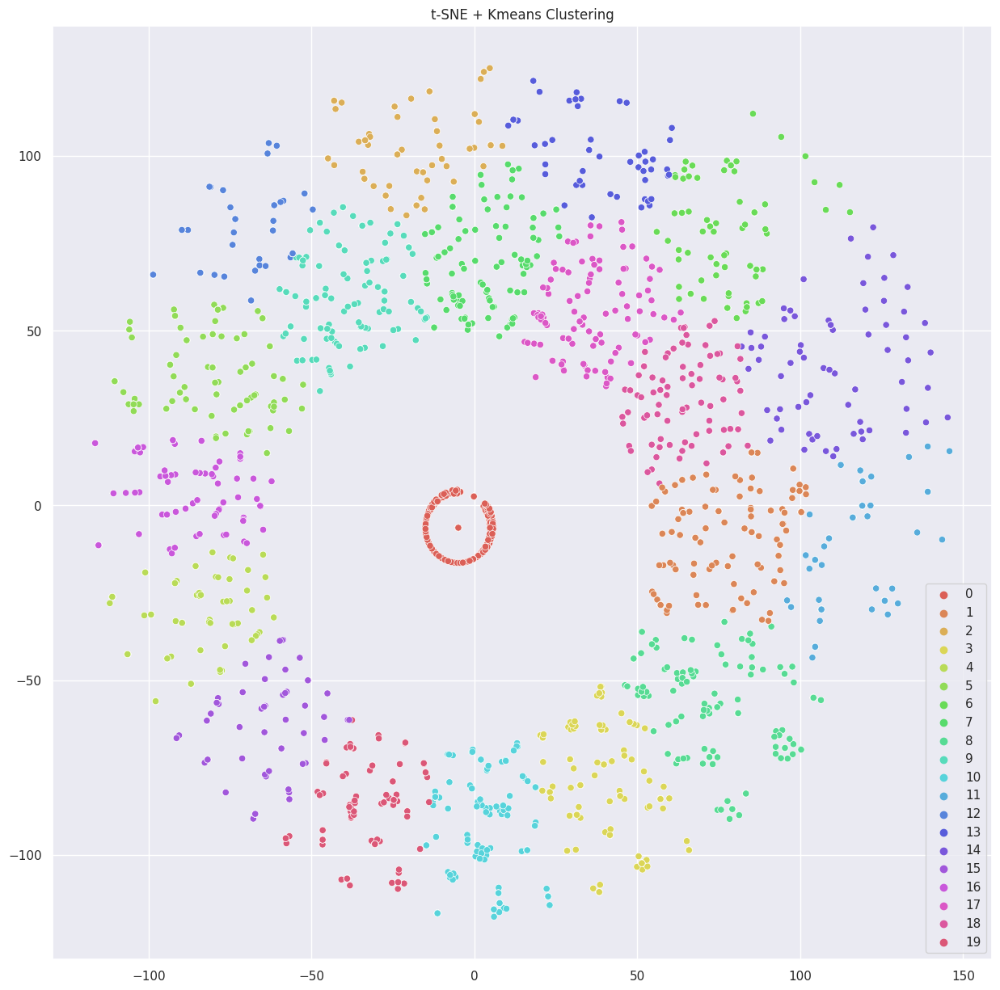

In [61]:
sns.set(rc={'figure.figsize': (15, 15)})
palette = sns.color_palette("hls", 20)
sns.scatterplot(x=X_embedded[:, 0], y=X_embedded[:, 1], hue=cluster_labels, palette=palette, legend='full')
title = f"t-SNE + Kmeans Clustering"
plt.title(title)
plt.show()

Silhouette Score: 0.6751


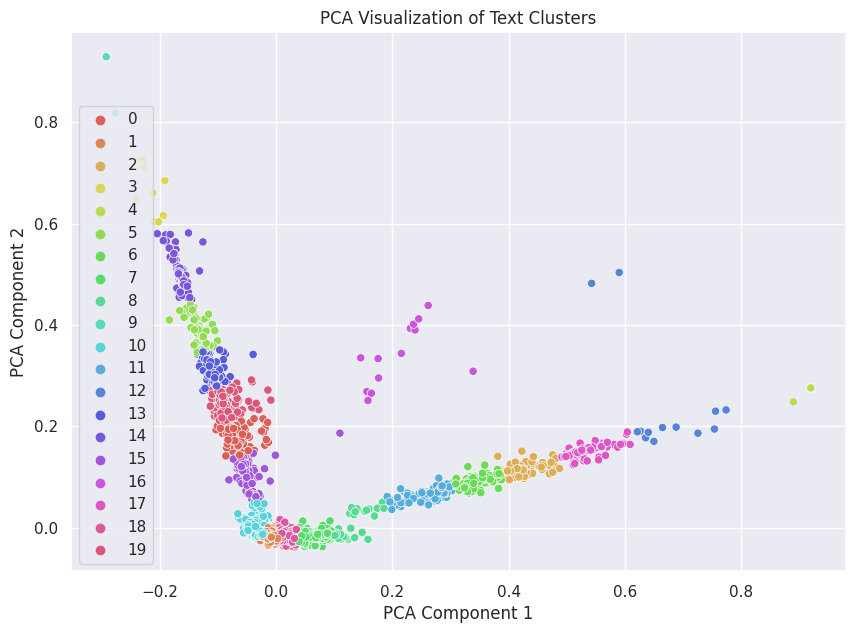

In [94]:
vectorizer = TfidfVectorizer(ngram_range=(2, 2), max_features=2**10)
text_to_vector = vectorizer.fit_transform(df.data_str.values)

# Step 2: PCA dimensionality reduction (e.g., 2D or more)
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(text_to_vector.toarray())

# Step 3: KMeans Clustering on PCA-transformed data
kmeans = KMeans(n_clusters=20, random_state=42, n_init='auto')
cluster_labels = kmeans.fit_predict(X_pca)

# Step 4: Silhouette Score
score = silhouette_score(X_pca, cluster_labels)
print(f"Silhouette Score: {score:.4f}")

# Step 5: Plot PCA-visualized clusters
plt.figure(figsize=(10,7))
palette = sns.color_palette("hls", 20)
sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=cluster_labels, palette=palette, legend='full')
plt.title("PCA Visualization of Text Clusters")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.grid(True)
plt.show()


# Apply k-means on test data

In [88]:
# New text article (related to graphics)
new_article = """Graphics rendering has significantly improved with the latest advancements 
in GPU technology. Modern graphics cards support real-time ray tracing, allowing for 
high-quality visual effects in gaming and professional design software."""

# (Optional) Preprocessing if you used one before
new_article = preprocess(new_article)

# Vectorize
new_vector = vectorizer.transform([new_article])

# Reduce dimensions using SAME PCA
new_vector_pca = pca.transform(new_vector.toarray())

# Predict cluster
predicted_cluster = kmeans.predict(new_vector_pca)[0]
print(f"Predicted Cluster for new article: {predicted_cluster}")


Predicted Cluster for new article: 1


In [89]:
out = df[df['target'] == 1]
print(out['target_names'].iloc[0])


comp.graphics


In [91]:
import pickle

with open('vectorizer.pkl', 'wb') as f:
    pickle.dump(vectorizer, f)

with open('pca.pkl', 'wb') as f:
    pickle.dump(pca, f)

with open('kmeans.pkl', 'wb') as f:
    pickle.dump(kmeans, f)


In [92]:
import gzip

with open("vectorizer.pkl", "rb") as f_in:
    with gzip.open("vectorizer_compressed.pkl.gz", "wb") as f_out:
        f_out.writelines(f_in)

print("Compression complete: vectorizer_compressed.pkl.gz created.")


Compression complete: vectorizer_compressed.pkl.gz created.


## Hierarchical  clustering

In [44]:
from sklearn.cluster import AgglomerativeClustering
agg_cluster = AgglomerativeClustering(n_clusters=20, affinity='euclidean', linkage='ward')
text_to_vector = vectorizer.fit_transform(df.data_str.values)
X_embedded=t_sne.fit_transform(text_to_vector.toarray())
agg_labels = agg_cluster.fit_predict(X_embedded)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


In [45]:
score = silhouette_score(X_embedded, agg_labels)
print("Silhouette Score:", score)

Silhouette Score: 0.85145766


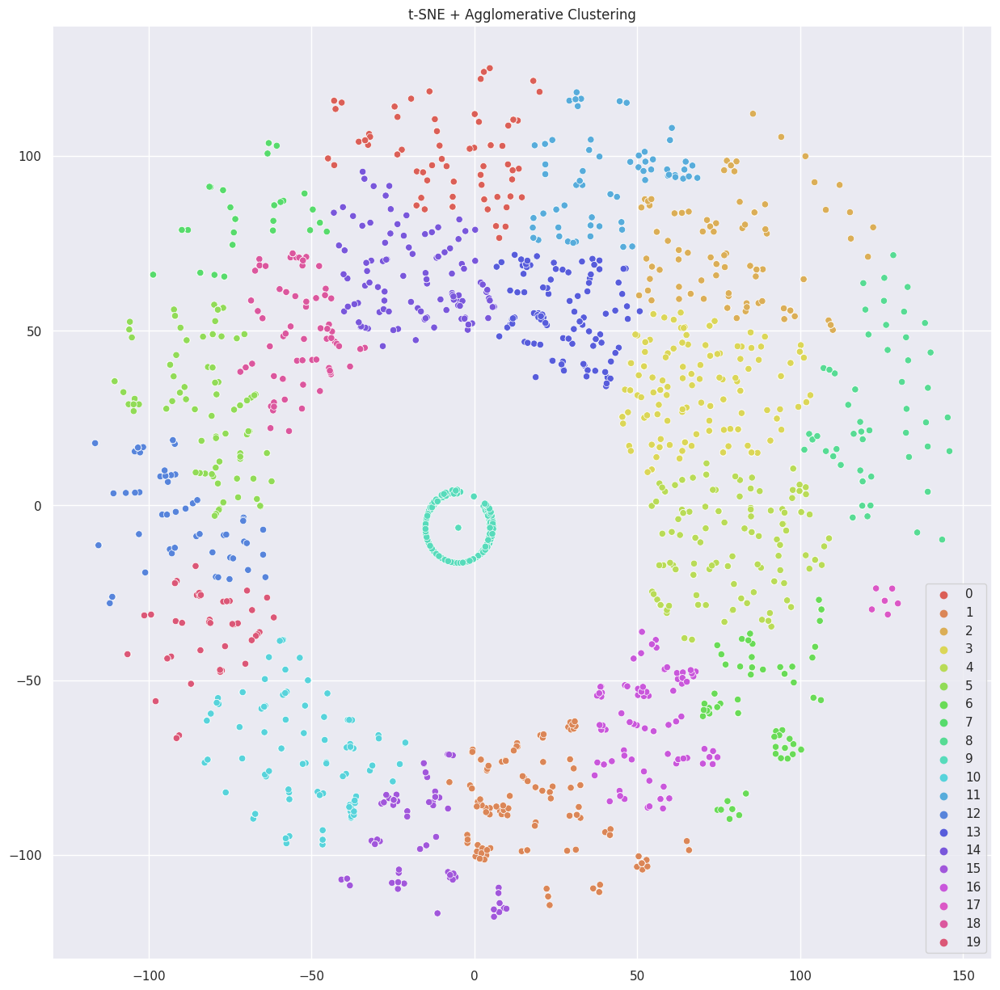

In [46]:
sns.set(rc={'figure.figsize': (15, 15)})
palette = sns.color_palette("hls", 20)
sns.scatterplot(x=X_embedded[:, 0], y=X_embedded[:, 1], hue=agg_labels, palette=palette, legend='full')
title = f"t-SNE + Agglomerative Clustering"
plt.title(title)
plt.show()

## GaussianMixture Model

In [47]:
from sklearn.mixture import GaussianMixture
gmm = GaussianMixture(n_components=20, random_state=42)
text_to_vector = vectorizer.fit_transform(df.data_str.values)
X_embedded=t_sne.fit_transform(text_to_vector.toarray())
gmm.fit(X_embedded)



GaussianMixture(n_components=20, random_state=42)

In [49]:
y_gmm_pred = gmm.predict(X_embedded)

In [52]:
print("Log Likelihood:", gmm.score(X_embedded))

Log Likelihood: 6.5973011367310965


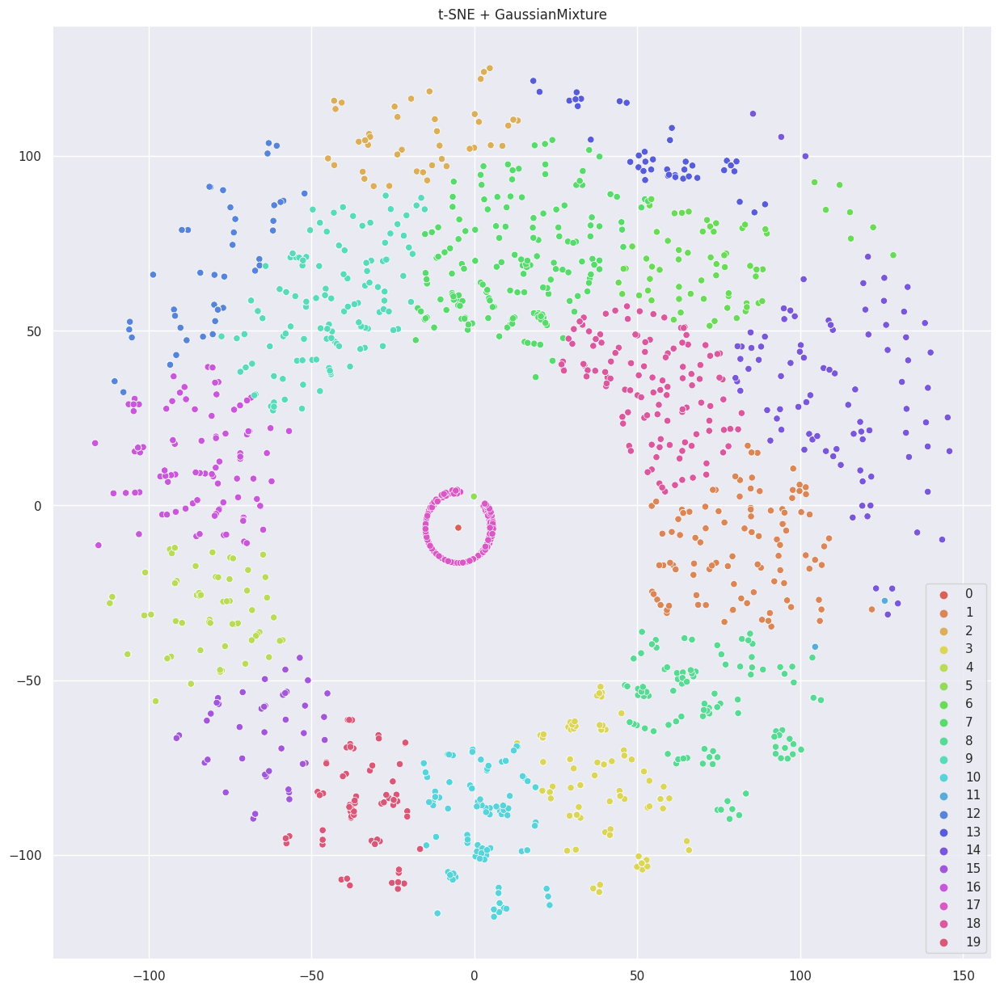

In [50]:
sns.set(rc={'figure.figsize': (15, 15)})
palette = sns.color_palette("hls", 20)
sns.scatterplot(x=X_embedded[:, 0], y=X_embedded[:, 1], hue=y_gmm_pred, palette=palette, legend='full')
title = f"t-SNE + GaussianMixture"
plt.title(title)
plt.show()